### Customer Transaction Prediction


### Importing necessary Libraries

In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection   import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics  import confusion_matrix
from sklearn.model_selection import cross_val_score,cross_validate
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_curve,auc
from sklearn.metrics import roc_auc_score,precision_recall_curve
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBClassifier

%matplotlib inline

### Loading test train data


In [2]:
train = pd.read_csv("train(1).csv")
train.head()

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104


In [3]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 202 entries, ID_code to var_199
dtypes: float64(200), int64(1), object(1)
memory usage: 308.2+ MB


In [4]:
train.describe()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,...,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000
mean,0.100490,10.679914,-1.627622,10.715192,6.796529,11.078333,-5.065317,5.408949,16.545850,0.284162,...,3.234440,7.438408,1.927839,3.331774,17.993784,-0.142088,2.303335,8.908158,15.870720,-3.326537
std,0.300653,3.040051,4.050044,2.640894,2.043319,1.623150,7.863267,0.866607,3.418076,3.332634,...,4.559922,3.023272,1.478423,3.992030,3.135162,1.429372,5.454369,0.921625,3.010945,10.438015
min,0.000000,0.408400,-15.043400,2.117100,-0.040200,5.074800,-32.562600,2.347300,5.349700,-10.505500,...,-14.093300,-2.691700,-3.814500,-11.783400,8.694400,-5.261000,-14.209600,5.960600,6.299300,-38.852800
25%,0.000000,8.453850,-4.740025,8.722475,5.254075,9.883175,-11.200350,4.767700,13.943800,-2.317800,...,-0.058825,5.157400,0.889775,0.584600,15.629800,-1.170700,-1.946925,8.252800,13.829700,-11.208475
50%,0.000000,10.524750,-1.608050,10.580000,6.825000,11.108250,-4.833150,5.385100,16.456800,0.393700,...,3.203600,7.347750,1.901300,3.396350,17.957950,-0.172700,2.408900,8.888200,15.934050,-2.819550
75%,0.000000,12.758200,1.358625,12.516700,8.324100,12.261125,0.924800,6.003000,19.102900,2.937900,...,6.406200,9.512525,2.949500,6.205800,20.396525,0.829600,6.556725,9.593300,18.064725,4.836800
max,1.000000,20.315000,10.376800,19.353000,13.188300,16.671400,17.251600,8.447700,27.691800,10.151300,...,18.440900,16.716500,8.402400,18.281800,27.928800,4.272900,18.321500,12.000400,26.079100,28.500700


In [5]:
train.shape

(200000, 202)

### Data types in train dataset


In [6]:
train.dtypes.value_counts()

float64    200
object       1
int64        1
dtype: int64

In [7]:
#storing ID_code  of test tarin data 
train_ID_code_orignal = train.ID_code

In [8]:
#droping ID_code in train
train.drop(columns="ID_code" ,inplace =True )
print(train.shape)

(200000, 201)


### Checking distribution of target variable

<AxesSubplot: xlabel='target', ylabel='count'>

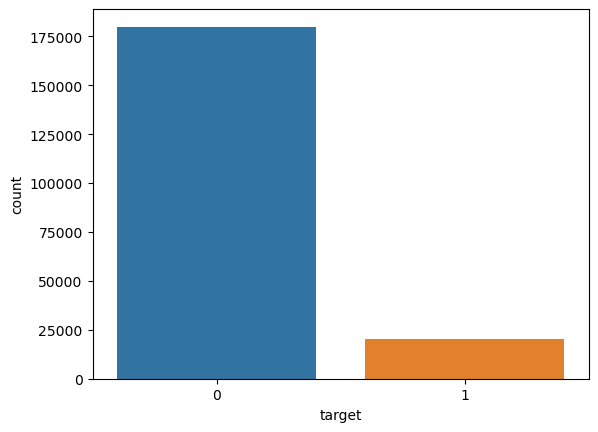

In [9]:
#plot bar
sns.countplot(x = 'target', data = train)

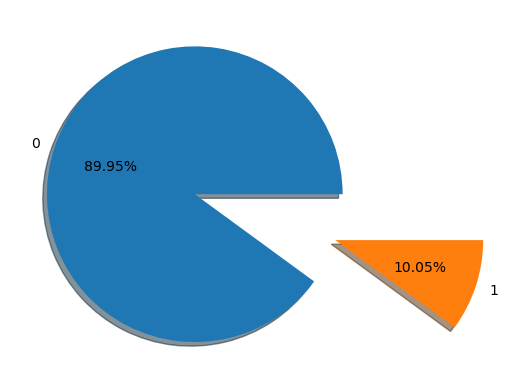

In [10]:
# pie chart
plt.pie(train['target'].value_counts() , labels=[0,1] ,autopct='%1.2f%%' ,explode=(0,1) ,shadow=True)
plt.show()

### Observations

    1. There is high imbalance between classes in taget class
    
    2. The number of observations in class 0 is more the class 1 (90% class 0 ,10% class 1)
    
    3. The number of people that will not make transaction is more than the one who will make

In [11]:
train.isnull().sum()

target     0
var_0      0
var_1      0
var_2      0
var_3      0
          ..
var_195    0
var_196    0
var_197    0
var_198    0
var_199    0
Length: 201, dtype: int64

In [12]:
#checking for missing values in train data
train.isna().sum().sum()

0

#### No missing values in both test and train data

### Independent dependent variable split

In [13]:
X = train.drop(columns='target',axis = 1)

In [14]:
X

,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,-4.9200,5.7470,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,3.1468,8.0851,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,-4.9193,5.9525,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,-5.8609,8.2450,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,6.2654,7.6784,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,-0.6209,5.6669,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
199996,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,-3.6797,6.0019,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
199997,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,0.1202,6.1629,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995
199998,9.7148,-8.6098,13.6104,5.7930,12.5173,0.5339,6.0479,17.0152,-2.1926,8.7542,...,2.6840,8.6587,2.7337,11.1178,20.4158,-0.0786,6.7980,10.0342,15.5289,-13.9001


In [15]:
Y = train['target']

In [16]:
Y

0         0
1         0
2         0
3         0
4         0
         ..
199995    0
199996    0
199997    0
199998    0
199999    0
Name: target, Length: 200000, dtype: int64

Distribution of Columns


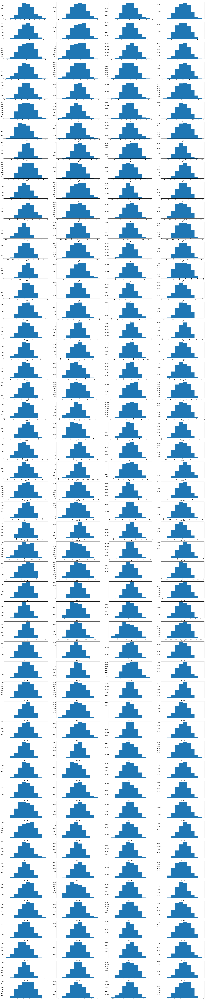

In [17]:
#hisograms are used to check distribution of data 
#draw histograms of numeric data in training set 
print("Distribution of Columns")
plt.figure(figsize=(40,200))
for i,col in enumerate(X):
    plt.subplot(50,4,i+1)
    plt.hist(train[col])
    plt.title(col) 

#### Observation Variable Distribution Train data

#### Almost all Distributions of variables are normal

Distribution of columns per target class


C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==0][col],hist=False,label='0',color='green')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==0][col],hist=False,label='0',color='green')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==0][col],hist=False,label='0',color='green')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==0][col],hist=False,label='0',color='green')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==0][col],hist=False,label='0',color='green')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')
C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3933309180.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sn

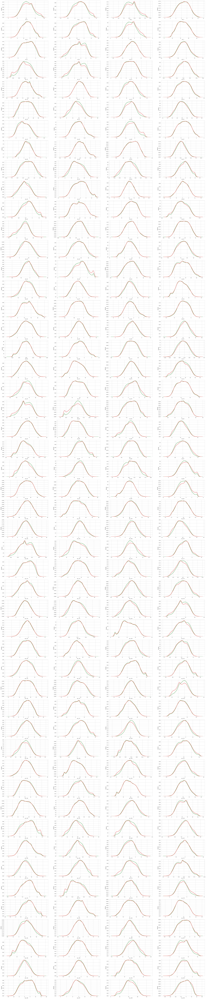

In [18]:
print("Distribution of columns per target class")
sns.set_style('whitegrid')
plt.figure(figsize=(40,200))
for i,col in enumerate(X):
    plt.subplot(50,4,i+1)
    sns.distplot(train[train['target']==0][col],hist=False,label='0',color='green')
    sns.distplot(train[train['target']==1][col],hist=False,label='1',color='red')

### STATISTICAL ANALYSIS

### DISTRIBUTION OF MEAN AND STANDARD DEVIATION OF THE DATA

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3269960260.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[features].mean(axis=1),color='Blue', kde=True,bins=120)


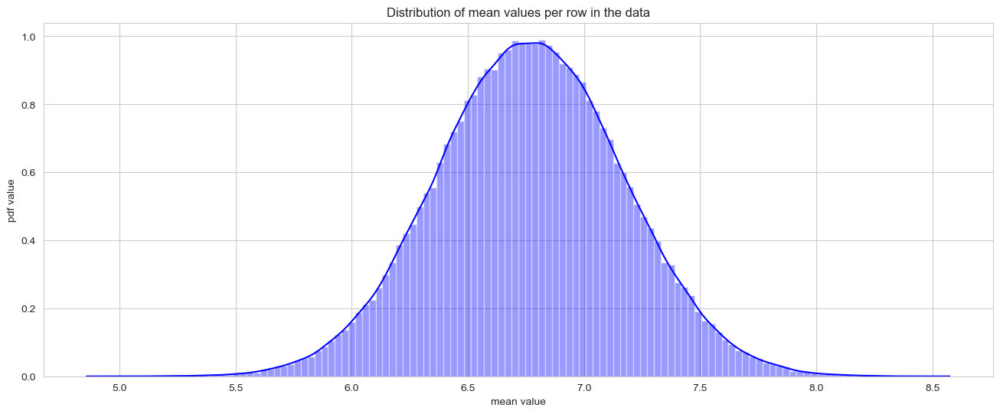

In [19]:
plt.figure(figsize=(16,6))
sns.set_style('whitegrid')
features = train.columns.values[1:202]
plt.title('Distribution of mean values per row in the data')
plt.xlabel('mean value')
plt.ylabel('pdf value')
sns.distplot(train[features].mean(axis=1),color='Blue', kde=True,bins=120)
plt.show()

* From the above graph looks like guassian distribution with mean value 6.73

* From above graph we can say that around 80% feature mean lies between 6.5 to 7.0

### DISTRIBUTION OF STANDARD DEVIATION OF DATA

C:\Users\Test\AppData\Local\Temp\ipykernel_11648\3483188684.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(train[features].std(axis=1),color='BLUE', kde=True,bins=120)


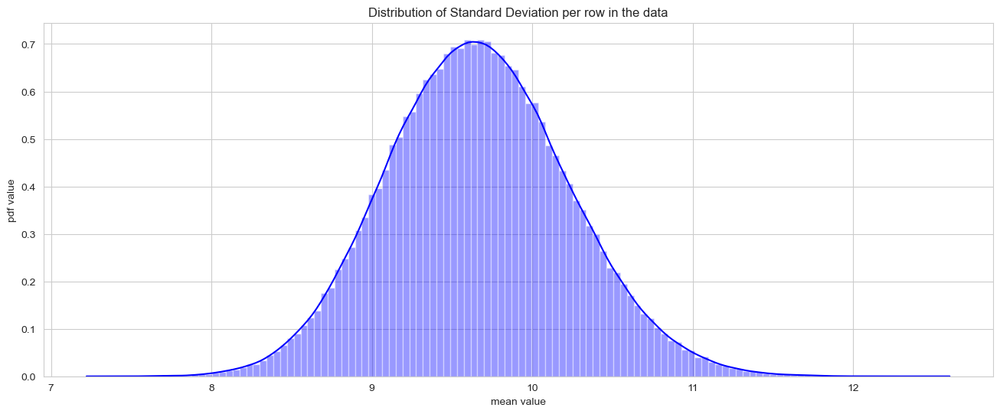

In [20]:
plt.figure(figsize=(16,6))
sns.set_style('whitegrid')
features = train.columns.values[1:202]
plt.title('Distribution of Standard Deviation per row in the data')
plt.xlabel('mean value')
plt.ylabel('pdf value')
sns.distplot(train[features].std(axis=1),color='BLUE', kde=True,bins=120)
plt.show()

### OBSERVATION:
    
#### This graph also look like guassian distribution around 60% of feature standard deviation around the range of 9 to 10

### 2.OUTLIER HANDLING

* From the above EDA we seen the feature are very close to the normal distribution as well as distance between point is very less so we are not impute the outlier we are use scaling to robust the outlier

### 3.FEATURE SCALING

### ROBUST SCALEING

 * Here we are use robust scaling because the data set contain the outlier but feature is follow a normal distribution
 * robust scaler is similar to normalization but it instead uses the interquatile range, so that is robust to outlier

In [21]:
from sklearn.preprocessing import RobustScaler # Import library
scaler = RobustScaler() # Object creation
train[['var_0','var_1','var_2','var_3','var_4','var_5','var_6','var_7','var_8','var_9','var_10','var_11','var_12','var_13',
      'var_14','var_15','var_16','var_17','var_18','var_19','var_20','var_21','var_22','var_23','var_24','var_25','var_26',
      'var_27','var_28','var_29','var_30','var_31','var_32','var_33','var_34','var_35','var_36','var_37','var_38','var_39',
      'var_40','var_41','var_42','var_43','var_44','var_45','var_46','var_47','var_48','var_49','var_50','var_51','var_52',
      'var_53','var_54','var_55','var_56','var_57','var_58','var_59','var_60','var_61','var_62','var_63','var_64','var_65',
      'var_66','var_67','var_68','var_69','var_70','var_71','var_72','var_73','var_74','var_75','var_76','var_77','var_78',
      'var_79','var_80','var_81','var_82','var_83','var_84','var_85','var_86','var_87','var_88','var_89','var_90','var_91',
      'var_92','var_93','var_94','var_95','var_96','var_97','var_98','var_99','var_100','var_101','var_102','var_103',
      'var_104','var_105','var_106','var_107','var_108','var_109','var_110','var_111','var_112','var_113','var_114',
      'var_115','var_116','var_117','var_118','var_119','var_120','var_121','var_122','var_123','var_124','var_125',
      'var_126','var_127','var_128','var_129','var_130','var_131','var_132','var_133','var_134','var_135','var_136','var_137',
      'var_138','var_139','var_140','var_141','var_142','var_143','var_144','var_145','var_146','var_147','var_148','var_149',
      'var_150','var_151','var_152','var_153','var_154','var_155','var_156','var_157','var_158','var_159','var_160','var_161',
      'var_162','var_163','var_164','var_165','var_166','var_167','var_168','var_169','var_170','var_171','var_172','var_173',
      'var_174','var_175','var_176','var_177','var_178','var_179','var_180','var_181','var_182','var_183','var_184','var_185',
      'var_186','var_187','var_188','var_189','var_190','var_191','var_192','var_193','var_194','var_195','var_196','var_197',
      'var_198','var_199',]] = scaler.fit_transform(train[['var_0','var_1','var_2','var_3','var_4','var_5','var_6','var_7',
      'var_8','var_9','var_10','var_11','var_12','var_13',
      'var_14','var_15','var_16','var_17','var_18','var_19','var_20','var_21','var_22','var_23','var_24','var_25','var_26',
      'var_27','var_28','var_29','var_30','var_31','var_32','var_33','var_34','var_35','var_36','var_37','var_38','var_39',
      'var_40','var_41','var_42','var_43','var_44','var_45','var_46','var_47','var_48','var_49','var_50','var_51','var_52',
      'var_53','var_54','var_55','var_56','var_57','var_58','var_59','var_60','var_61','var_62','var_63','var_64','var_65',
      'var_66','var_67','var_68','var_69','var_70','var_71','var_72','var_73','var_74','var_75','var_76','var_77','var_78',
      'var_79','var_80','var_81','var_82','var_83','var_84','var_85','var_86','var_87','var_88','var_89','var_90','var_91',
      'var_92','var_93','var_94','var_95','var_96','var_97','var_98','var_99','var_100','var_101','var_102','var_103',
      'var_104','var_105','var_106','var_107','var_108','var_109','var_110','var_111','var_112','var_113','var_114',
      'var_115','var_116','var_117','var_118','var_119','var_120','var_121','var_122','var_123','var_124','var_125',
      'var_126','var_127','var_128','var_129','var_130','var_131','var_132','var_133','var_134','var_135','var_136','var_137',
      'var_138','var_139','var_140','var_141','var_142','var_143','var_144','var_145','var_146','var_147','var_148','var_149',
      'var_150','var_151','var_152','var_153','var_154','var_155','var_156','var_157','var_158','var_159','var_160','var_161',
      'var_162','var_163','var_164','var_165','var_166','var_167','var_168','var_169','var_170','var_171','var_172','var_173',
      'var_174','var_175','var_176','var_177','var_178','var_179','var_180','var_181','var_182','var_183','var_184','var_185',
      'var_186','var_187','var_188','var_189','var_190','var_191','var_192','var_193','var_194','var_195','var_196','var_197',
      'var_198','var_199']])

In [22]:
train.head()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,0,-0.371543,-0.849081,0.350032,-0.564165,0.148216,-0.367026,-0.215656,0.420577,-1.011036,...,0.190533,-0.776912,0.599643,-0.303378,0.118478,-1.112383,0.643194,-0.242223,-0.744683,0.107705
1,0,0.226713,-0.416363,0.864155,-0.467749,0.527324,0.979489,0.190804,0.014925,0.523831,...,0.686540,0.085795,0.331306,1.344064,-0.530228,1.103135,0.672394,-0.074077,0.571886,0.297368
2,0,-0.445003,-0.186541,0.395469,0.347815,-0.221094,-0.350556,1.260908,-0.356903,-1.010902,...,-0.046079,0.560891,-0.112102,-0.304303,0.764938,1.656951,-1.050161,-0.463036,-0.286149,0.200436
3,0,0.124444,-0.089159,-0.429020,0.120748,0.620850,0.247176,0.370517,-0.296912,-1.190060,...,0.195359,-0.598020,-0.574591,-0.351340,1.065039,-0.548868,-0.627542,1.047370,0.480670,-0.385163
4,0,-0.159803,0.020439,0.604761,-0.061074,0.491579,0.600549,0.449607,0.541684,1.117206,...,-0.726076,0.499102,-0.996298,1.031426,-0.979782,-0.669600,0.178488,0.458709,0.487211,-0.373372


* Scale data successfully

In [23]:
train.corr()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
target,1.000000,0.052390,0.050343,0.055870,0.011055,0.010915,0.030979,0.066731,-0.003025,0.019584,...,0.055973,0.047114,-0.042858,-0.017709,-0.022838,0.028285,0.023608,-0.035303,-0.053000,0.025434
var_0,0.052390,1.000000,-0.000544,0.006573,0.003801,0.001326,0.003046,0.006983,0.002429,0.004962,...,0.002752,0.000206,-0.005373,0.001616,-0.001514,0.002073,0.004386,-0.000753,-0.005776,0.003850
var_1,0.050343,-0.000544,1.000000,0.003980,0.000010,0.000303,-0.000902,0.003258,0.001511,0.004098,...,0.006627,0.003621,-0.002604,0.001153,-0.002557,-0.000785,-0.000377,-0.004157,-0.004861,0.002287
var_2,0.055870,0.006573,0.003980,1.000000,0.001001,0.000723,0.001569,0.000883,-0.000991,0.002648,...,0.000197,0.001285,-0.003400,0.000549,0.002104,-0.001070,0.003952,0.001078,-0.000877,0.003855
var_3,0.011055,0.003801,0.000010,0.001001,1.000000,-0.000322,0.003253,-0.000774,0.002500,0.003553,...,0.000151,0.002445,-0.001530,-0.001699,-0.001054,0.001206,-0.002800,0.001164,-0.001651,0.000506
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
var_195,0.028285,0.002073,-0.000785,-0.001070,0.001206,0.003706,-0.001274,0.001244,0.001854,0.001396,...,0.004571,0.000870,-0.004745,-0.003143,-0.001201,1.000000,0.002517,-0.004170,-0.000536,0.002042
var_196,0.023608,0.004386,-0.000377,0.003952,-0.002800,0.000513,0.002880,0.005378,0.001045,-0.003242,...,-0.000847,0.002466,-0.001386,-0.005308,-0.005040,0.002517,1.000000,-0.000454,0.000253,0.000607
var_197,-0.035303,-0.000753,-0.004157,0.001078,0.001164,-0.000046,-0.000535,-0.003565,0.003466,-0.004583,...,-0.004974,0.000906,-0.000527,0.005068,0.000884,-0.004170,-0.000454,1.000000,0.001183,0.004991
var_198,-0.053000,-0.005776,-0.004861,-0.000877,-0.001651,-0.001821,-0.000953,-0.003025,0.000650,0.002950,...,-0.000153,-0.000067,0.003451,0.001646,0.003194,-0.000536,0.000253,0.001183,1.000000,-0.004731


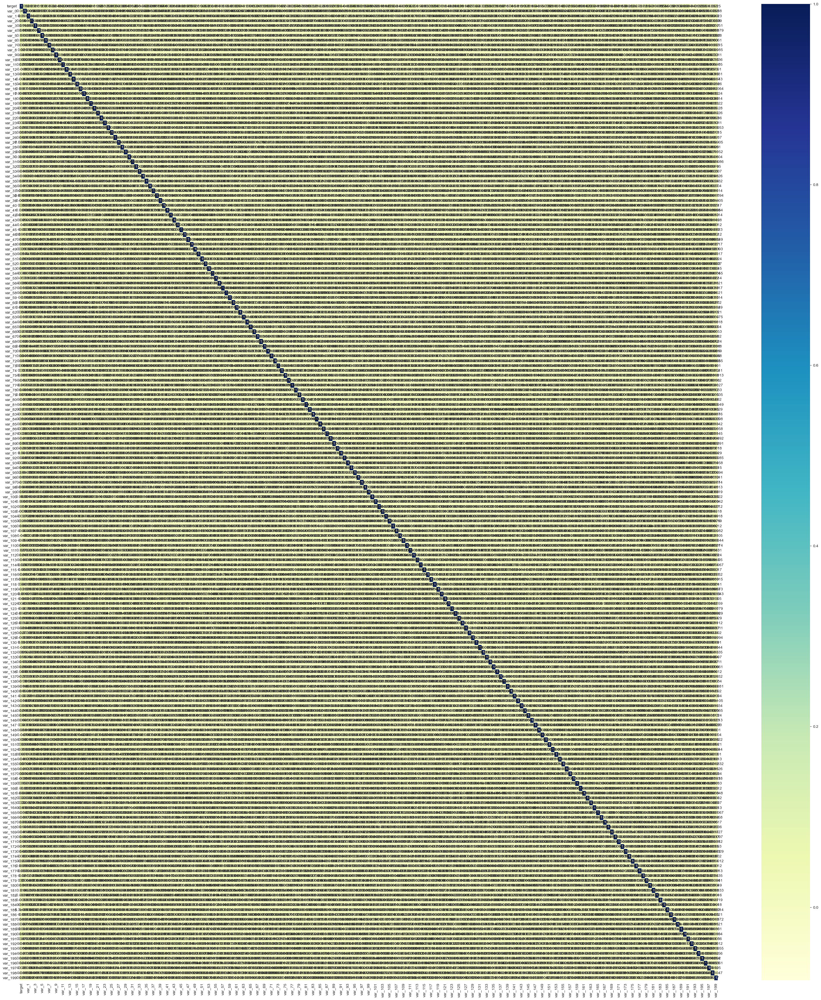

In [62]:
# Plot hitmap for better visualisation
plt.figure(figsize=(40,45))
sns.heatmap(train.corr(),annot=True,cmap='YlGnBu')
plt.show()

* From above heatmap scale we are clearly seen that their is no highly correlated feature in data
* But we confirm with the help of python code

### CHECKING DUPLICATES

In [25]:
train.duplicated().sum()

0

Their is no duplicates avialable on data

### PRINCIPLE COMPONENT ANALYSIS

* Reduce the feature with the help of pca

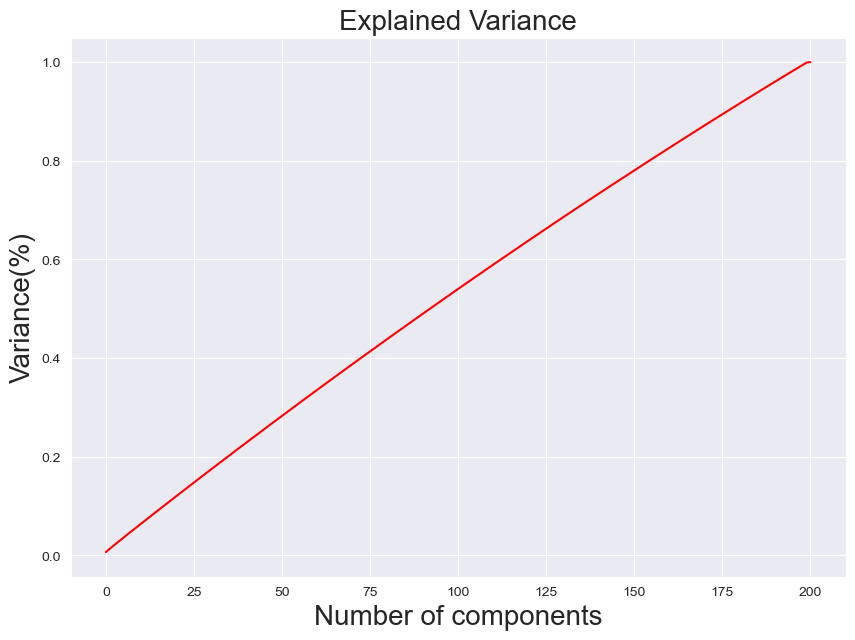

In [26]:
# Getting the optimal value of pca
from sklearn.decomposition import PCA
pca = PCA() # Object creation
principlecomponent = pca.fit_transform(train)  # Fitting the data
plt.figure(figsize=(10,7))
sns.set_style('darkgrid')
plt.plot(np.cumsum(pca.explained_variance_ratio_),color ='r')
plt.xlabel('Number of components',fontsize=20)
plt.ylabel('Variance(%)',fontsize=20) # for each componant
plt.title('Explained Variance',fontsize=20)
plt.show()

* In this plot we clearly seen the line of no of components is straight means the feature is more important so we are going to select 175 feature because of less variance loss

In [27]:
# Selecting the components
pca = PCA(n_components=175)
new_data = pca.fit_transform(train)
new_data

array([[-0.51758867,  0.26955976,  0.05402251, ...,  0.91197506,
         0.02825685, -0.01823824],
       [ 1.32400732, -0.53357927,  1.95817087, ...,  0.11897006,
        -0.04993349, -0.091531  ],
       [-0.04224386, -0.81522866, -0.3257926 , ...,  0.04433698,
        -1.15220835, -0.52020052],
       ...,
       [ 0.01423866,  0.55522966,  0.65142503, ...,  0.13624811,
        -0.40374922,  0.61777042],
       [-0.40689894,  0.23820526,  0.38221209, ..., -0.55847262,
         0.11239184, -0.75789081],
       [-0.76575485, -0.16503883,  0.39951196, ...,  1.09182605,
        -0.47622989,  0.67725346]])

In [28]:
# Create a new dataframe
principle_df = pd.DataFrame(data=new_data,columns=['pca1','pca2','pca3','pca4','pca5','pca6','pca7','pca8','pca9','pca10',
                            'pca11','pca12','pca13','pca14','pca15','pca16','pca17','pca18','pca19','pca20','pca21','pca22',
                            'pca23','pca24','pca25','pca26','pca27','pca28','pca29','pca30','pca31','pca32','pca33','pca34',
                            'pca35','pca36','pca37','pca38','pca39','pca40','pca41','pca42','pca43','pca44','pca45','pca46',
                            'pca47','pca48','pca49','pca50','pca51','pca52','pca53','pca54','pca55','pca56','pca57','pca58',
                            'pca59','pca60','pca61','pca62','pca63','pca64','pca65','pca66','pca67','pca68','pca69','pca70',
                            'pca71','pca72','pca73','pca74','pca75','pca76','pca77','pca78','pca79','pca80','pca81','pca82',
                            'pca83','pca84','pca85','pca86','pca87','pca88','pca89','pca90','pca91','pca92','pca93','pca94',
                            'pca95','pca96','pca97','pca98','pca99','pca100','pca101','pca102','pca103','pca104','pca105',
                            'pca106','pca107','pca108','pca109','pca110','pca111','pca112','pca113','pca114','pca115','pca116',
                            'pca117','pca118','pca119','pca120','pca121','pca122','pca123','pca124','pca125','pca126','pca127',
                            'pca128','pca129','pca130','pca131','pca132','pca133','pca134','pca135','pca136','pca137','pca138',
                            'pca139','pca140','pca141','pca142','pca143','pca144','pca145','pca146','pca147','pca148','pca149',
                            'pca150','pca151','pca152','pca153','pca154','pca155','pca156','pca157','pca158','pca159','pca160',
                            'pca161','pca162','pca163','pca164','pca165','pca166','pca167','pca168','pca169','pca170',
                            'pca171','pca172','pca173','pca174','pca175'])
principle_df.head()

,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10,...,pca166,pca167,pca168,pca169,pca170,pca171,pca172,pca173,pca174,pca175
0,-0.517589,0.269560,0.054023,-0.369893,-0.835381,-0.662795,-1.319730,-1.064223,0.849499,0.433281,...,0.554410,-0.611039,-1.112001,0.258308,0.751815,-0.967646,-0.750007,0.911975,0.028257,-0.018238
1,1.324007,-0.533579,1.958171,1.308587,-0.328150,-0.049564,1.179654,-0.139923,-0.443926,0.601061,...,0.807269,0.357139,1.262798,0.132334,-0.126031,-0.782291,0.295756,0.118970,-0.049933,-0.091531
2,-0.042244,-0.815229,-0.325793,0.225673,0.013017,-0.143188,-0.106796,0.226355,0.768914,0.082743,...,-0.571805,0.691044,-0.271241,0.335684,0.558622,-0.601425,-0.833146,0.044337,-1.152208,-0.520201
3,1.384955,0.367701,0.459503,-0.644095,-0.384638,0.117310,1.266890,-0.159772,-0.618706,0.584172,...,-1.503312,0.682461,0.035037,-0.304494,0.194574,0.874634,-0.182145,-0.717708,0.512492,0.430749
4,0.592824,-0.160891,0.584662,-0.840627,0.147873,-0.404153,-0.678792,0.868974,0.354538,-0.451727,...,0.459845,-0.455293,0.147366,-1.475875,-0.264492,-0.164119,-0.102101,-0.239766,-0.584007,-0.161014


### MODEL CREATION

### AIM

* In customer transaction prediction f1 score metrix is important so we need more focus to improve f1 score
* Create a sweet spot model (Low bias, Low variance)

### EXPERIMENTING WITH FOUR ALGORITHM

    1.Logistic Regression

    2.Artificial Neural Network [MLP Classifier]

    3.XGB Classifier

In [29]:
X = principle_df
y = train.target

In [30]:
X.head()

,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10,...,pca166,pca167,pca168,pca169,pca170,pca171,pca172,pca173,pca174,pca175
0,-0.517589,0.269560,0.054023,-0.369893,-0.835381,-0.662795,-1.319730,-1.064223,0.849499,0.433281,...,0.554410,-0.611039,-1.112001,0.258308,0.751815,-0.967646,-0.750007,0.911975,0.028257,-0.018238
1,1.324007,-0.533579,1.958171,1.308587,-0.328150,-0.049564,1.179654,-0.139923,-0.443926,0.601061,...,0.807269,0.357139,1.262798,0.132334,-0.126031,-0.782291,0.295756,0.118970,-0.049933,-0.091531
2,-0.042244,-0.815229,-0.325793,0.225673,0.013017,-0.143188,-0.106796,0.226355,0.768914,0.082743,...,-0.571805,0.691044,-0.271241,0.335684,0.558622,-0.601425,-0.833146,0.044337,-1.152208,-0.520201
3,1.384955,0.367701,0.459503,-0.644095,-0.384638,0.117310,1.266890,-0.159772,-0.618706,0.584172,...,-1.503312,0.682461,0.035037,-0.304494,0.194574,0.874634,-0.182145,-0.717708,0.512492,0.430749
4,0.592824,-0.160891,0.584662,-0.840627,0.147873,-0.404153,-0.678792,0.868974,0.354538,-0.451727,...,0.459845,-0.455293,0.147366,-1.475875,-0.264492,-0.164119,-0.102101,-0.239766,-0.584007,-0.161014


In [31]:
y

0         0
1         0
2         0
3         0
4         0
         ..
199995    0
199996    0
199997    0
199998    0
199999    0
Name: target, Length: 200000, dtype: int64

### BALANCING THE TARGET COLUMN USING SMOTE

In [32]:
from collections import Counter
from imblearn.over_sampling import SMOTE #SMOTE(synthetic minority oversampling techinque)
sm = SMOTE()
print("Unbalance Data : ", Counter(y))
X_sm,y_sm = sm.fit_resample(X,y)
print("Balance Data : ", Counter(y_sm))

Unbalance Data :  Counter({0: 179902, 1: 20098})
Balance Data :  Counter({0: 179902, 1: 179902})


### SPLIT TRAINING AND TESTING DATA

In [33]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X_sm,y_sm,random_state=42,test_size=0.30) 
# 30% data given to testing because the large amount of data

In [34]:
# Check shape of train and test
X_train.shape

(251862, 175)

In [35]:
X_test.shape

(107942, 175)

In [36]:
y_train.shape

(251862,)

In [37]:
y_test.shape

(107942,)

### Logistic Regression

In [38]:
#Step:1 importing library
from sklearn.linear_model import LogisticRegression

# Step:2 Object creation 
log_reg = LogisticRegression()

# Step:3 fitting traing data
log_reg.fit(X_train,y_train)

# Step:4 Prediction on test data
log_test_predict = log_reg.predict(X_test)

# Step:5 Prediction on training data
log_train_predict = log_reg.predict(X_train)

#### TRAINING ACCURACY

In [39]:
# Import library
from sklearn.metrics import accuracy_score,f1_score,recall_score,precision_score,classification_report,confusion_matrix
log_train_accuracy = accuracy_score(log_train_predict,y_train)
print("Training accuracy of Logistic regression model",log_train_accuracy*100)
print("Logistic regression training Classification report: \n",classification_report(log_train_predict,y_train))

Training accuracy of Logistic regression model 83.50684104787543
Logistic regression training Classification report: 
               precision    recall  f1-score   support

           0       0.83      0.84      0.83    124054
           1       0.84      0.83      0.84    127808

    accuracy                           0.84    251862
   macro avg       0.84      0.84      0.84    251862
weighted avg       0.84      0.84      0.84    251862



* Logistic regression training score is very poor

#### TESTING ACCURACY

In [40]:
log_test_accuracy = accuracy_score(log_test_predict,y_test)
print("Testing accuracy of Logistic regression model",log_test_accuracy*100)
print("Logistic regression testing Classification report: \n",classification_report(log_test_predict,y_test))

Testing accuracy of Logistic regression model 83.62175983398492
Logistic regression testing Classification report: 
               precision    recall  f1-score   support

           0       0.83      0.84      0.84     53159
           1       0.84      0.83      0.84     54783

    accuracy                           0.84    107942
   macro avg       0.84      0.84      0.84    107942
weighted avg       0.84      0.84      0.84    107942



* Testing accuracy of logistic regression model is poor so we use bagging to improve accuracy and f1 score

In [41]:
# In heaert customer transaction prediction f1 score is more important
log_f1_score = recall_score(log_test_predict,y_test)
log_f1_score*100

83.0987715167114

### USE BAGGING MEON LOGISTIC REGRESSION MODEL

In [42]:
# Step:1 Create a logictice regression object for bagging
log_reg1 = LogisticRegression()

# Step:2 importing library
from sklearn.ensemble import BaggingClassifier
bagg = BaggingClassifier(base_estimator=log_reg1,n_estimators=50)
#base_estimator---> algorithm which you want to pass
#n_estimotors-----> number of base learners

# Step:3 fitting the Training data
bagg.fit(X_train,y_train)

# Step:4 prediction on test data
bagg_predict = bagg.predict(X_test)

### EVALUATION

In [43]:
log_bagg_accuracy = accuracy_score(bagg_predict,y_test)
print("Testing accuracy of Logistic regession model after bagging",log_bagg_accuracy*100)
print("Logistic regression testing Classification report: \n",classification_report(bagg_predict,y_test))

Testing accuracy of Logistic regession model after bagging 83.62361268088418
Logistic regression testing Classification report: 
               precision    recall  f1-score   support

           0       0.83      0.84      0.84     53161
           1       0.84      0.83      0.84     54781

    accuracy                           0.84    107942
   macro avg       0.84      0.84      0.84    107942
weighted avg       0.84      0.84      0.84    107942



In [44]:
bagg_f1_score = f1_score(bagg_predict,y_test)
bagg_f1_score*100

83.74154978155897

 * After applying bagging score not improve

### ANN [MLP Classifier]

In [45]:
# Step:1 Importing library and object creation
from sklearn.neural_network import MLPClassifier
model = MLPClassifier(hidden_layer_sizes=(60,3),
                      learning_rate='constant',
                      max_iter=100,
                      random_state=42)

In [46]:
# Step:2 Fitting the training data
model.fit(X_train,y_train)

D:\Installed\Anaconda\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:692: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier(hidden_layer_sizes=(60, 3), max_iter=100, random_state=42)

In [47]:
# Step:3 Predicting the probability
mlp_prdict_probability = model.predict_proba(X_test)
mlp_prdict_probability

array([[9.99833170e-01, 1.66830257e-04],
       [1.17807146e-01, 8.82192854e-01],
       [3.92783454e-04, 9.99607217e-01],
       ...,
       [2.57508944e-03, 9.97424911e-01],
       [9.37315168e-01, 6.26848319e-02],
       [9.99400545e-01, 5.99455370e-04]])

In [48]:
# Step:4 Prediction on test data
mlp_test_predict = model.predict(X_test)

# Step:5 Prediction on training data
mlp_train_predict = model.predict(X_train)

#### EVALUATION

#### TRAINING ACCURACY

In [49]:
mlp_train_accuracy = accuracy_score(mlp_train_predict,y_train)
print("Training accuracy of MLP model is:",mlp_train_accuracy*100)
print("Classification report of training:"'\n',classification_report(mlp_train_predict,y_train))

Training accuracy of MLP model is: 93.61833067314642
Classification report of training:
               precision    recall  f1-score   support

           0       0.93      0.94      0.94    125185
           1       0.94      0.93      0.94    126677

    accuracy                           0.94    251862
   macro avg       0.94      0.94      0.94    251862
weighted avg       0.94      0.94      0.94    251862



* ANN MLP classifier model is very well work on training data

### TESTING ACCURACY

In [50]:
mlp_test_accuracy = accuracy_score(mlp_test_predict,y_test)
print("Testing accuracy of MLP model is:",mlp_test_accuracy*100)
print("Classification report of testing:"'\n',classification_report(mlp_test_predict,y_test))

Testing accuracy of MLP model is: 90.34296196105316
Classification report of testing:
               precision    recall  f1-score   support

           0       0.90      0.91      0.90     53084
           1       0.91      0.90      0.90     54858

    accuracy                           0.90    107942
   macro avg       0.90      0.90      0.90    107942
weighted avg       0.90      0.90      0.90    107942



In [51]:
mlp_f1_score = f1_score(mlp_test_predict,y_test)
print('F1 Score',mlp_f1_score*100)

F1 Score 90.4192937629823


 * ANN MLP classifier model testing accuracy also good.

### XGB Classifier

In [52]:
# Step:1 importing library and object creation
import xgboost
from xgboost import XGBClassifier
xgb = XGBClassifier()

# Step:2 fitting the training data
xgb.fit(X_train,y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [53]:
# Step:3 Prediction on training data
xgb_train_predict = xgb.predict(X_train)

# Step:4 Prediction on testing data
xgb_test_predict = xgb.predict(X_test)

#### EVALUATION

#### TRAINING ACCURACY

In [54]:
xgb_train_accuracy = accuracy_score(xgb_train_predict,y_train)
print("Training accuracy XGB classifier:",xgb_train_accuracy*100)
print("Classification report of training:"'\n',classification_report(xgb_train_predict,y_train))

Training accuracy XGB classifier: 93.77714780316205
Classification report of training:
               precision    recall  f1-score   support

           0       0.93      0.94      0.94    125069
           1       0.94      0.93      0.94    126793

    accuracy                           0.94    251862
   macro avg       0.94      0.94      0.94    251862
weighted avg       0.94      0.94      0.94    251862



* XGB Classifier model also very well work on training data

#### TESTING ACCURACY

In [55]:
xgb_test_accuracy = accuracy_score(xgb_test_predict,y_test)
print("Testing accuracy XGB classifier:",xgb_test_accuracy*100)
print("Classification report of training:"'\n',classification_report(xgb_test_predict,y_test))

Testing accuracy XGB classifier: 90.53751088547554
Classification report of training:
               precision    recall  f1-score   support

           0       0.90      0.91      0.90     53220
           1       0.91      0.90      0.91     54722

    accuracy                           0.91    107942
   macro avg       0.91      0.91      0.91    107942
weighted avg       0.91      0.91      0.91    107942



In [56]:
xgb_f1_score = f1_score(xgb_test_predict,y_test)
print("F1 score of xgb:",xgb_f1_score*100)

F1 score of xgb: 90.60055583163086


* XGB Classifier model accuracy score is also good.

### RandomForestClassifier

In [ ]:
# Step:1 importing library and object creation
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(n_estimators = 100) 

# Step:2 fitting the training data
rfc.fit(X_train,y_train)

In [58]:
# Step:3 Prediction on training data
rfc_train_predict = rfc.predict(X_train)

# Step:4 Prediction on testing data
rfc_test_predict = rfc.predict(X_test)

#### EVALUATION

#### TRAINING ACCURACY

In [59]:
rfc_train_accuracy = accuracy_score(rfc_train_predict,y_train)
print("Training accuracy RFC classifier:",rfc_train_accuracy*100)
print("Classification report of training:"'\n',classification_report(rfc_train_predict,y_train))

Training accuracy RFC classifier: 100.0
Classification report of training:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    125904
           1       1.00      1.00      1.00    125958

    accuracy                           1.00    251862
   macro avg       1.00      1.00      1.00    251862
weighted avg       1.00      1.00      1.00    251862



#### TESTING ACCURACY

In [60]:
rfc_test_accuracy = accuracy_score(rfc_test_predict,y_test)
print("Testing accuracy XGB classifier:",rfc_test_accuracy*100)
print("Classification report of training:"'\n',classification_report(rfc_test_predict,y_test))

Testing accuracy XGB classifier: 92.52098349113412
Classification report of training:
               precision    recall  f1-score   support

           0       0.91      0.94      0.92     52543
           1       0.94      0.91      0.93     55399

    accuracy                           0.93    107942
   macro avg       0.93      0.93      0.93    107942
weighted avg       0.93      0.93      0.93    107942



In [61]:
rfc_f1_score = f1_score(rfc_test_predict,y_test)
print("F1 score of xgb:",rfc_f1_score*100)

F1 score of xgb: 92.61681131851147


### OBSERVATION:
    
    1.logistic regression model training and testing score is not good after applying bagging score is still lagging.

    2 ANN MLP Classifeir model is very well work on training data as well as testing data the score of training is 93.87 and testing score is 90.47 with f1 score is 90.58

    3.XGB Classifier model is also well work on training and testing side the score of training 93.77 and testing score is 90.60 with f1 score is 90.67.
    
    4.RandomForest Classifier model is also well work on training and testing side the score of training 92.61 and testing score is 92.61 with f1 score is 92.61.

    5.From above all model we are select ANN MLP Classifier because we use certain parameter like max_iter.